### 1. 회전, 각도 변화

In [ ]:
!pip install opencv-python-headless

In [ ]:
#회전, 반전(상하 반전시 180도)
def rotate_image(image, angle):
    (h, w) = image.shape[:2]
    center = (w // 2, h // 2)


    # Perform the rotation
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    rotated = cv2.warpAffine(image, M, (w, h))
    return rotated

In [ ]:
def perspective_transform(image,a,b):
    (h, w) = image.shape[:2]

    # Define the points for perspective transformation
    src_points = np.float32([[0, 0], [w-1, 0], [0, h-1], [w-1, h-1]])
    dst_points = np.float32([[0, 0], [int(a*w), int(b*h)], [int(b*w), int(a*h)], [w-1, h-1]])

    # Get the transformation matrix
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    transformed = cv2.warpPerspective(image, M, (w, h))
    return transformed

In [ ]:
import random

def generate_random_pairs(pair_count):
    pairs = []
    for _ in range(pair_count):
        # 첫 번째 값을 랜덤하게 결정
        first_value = random.choice([random.uniform(0, 0.3), random.uniform(0.7, 1)])

        # 첫 번째 값에 따라 두 번째 값을 결정
        if first_value <= 0.3:
            second_value = random.uniform(0.8, 1)
        else:
            second_value = random.uniform(0, 0.2)

        # 두 값을 쌍으로 저장
        pairs.append([first_value, second_value])

    return pairs


In [ ]:
import random

def get_random_numbers(count, range_start, range_end):

    if count > (range_end - range_start + 1):
        raise ValueError("Count exceeds the number of unique values in the given range.")

    return random.sample(range(range_start, range_end + 1), count)


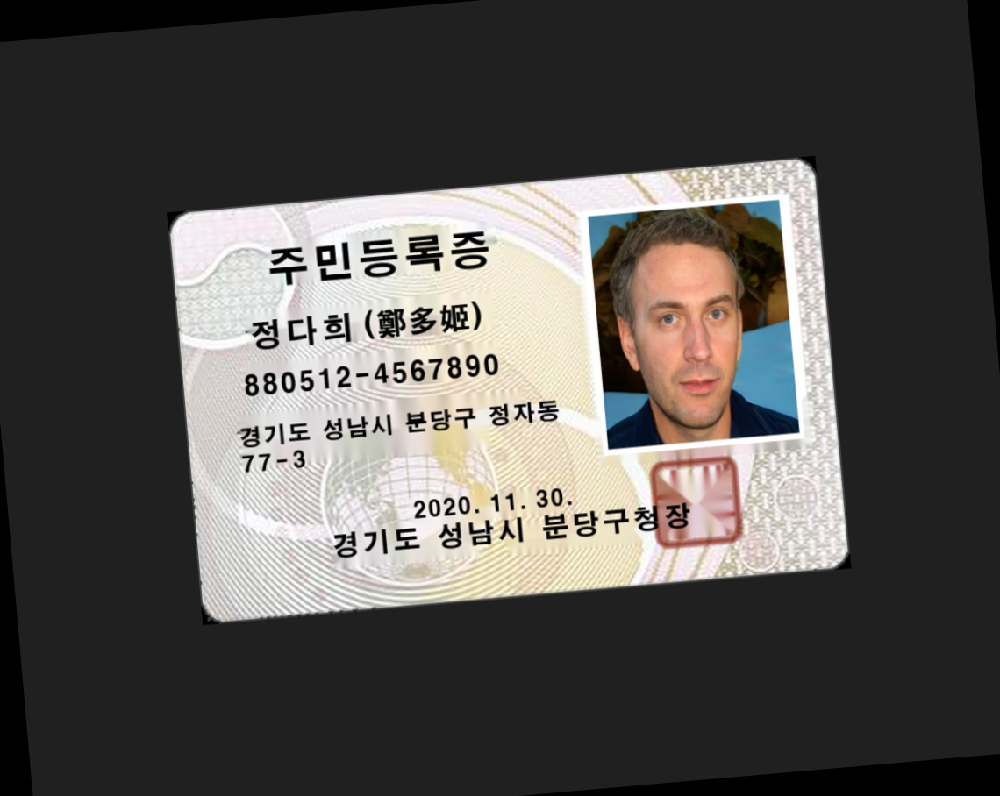

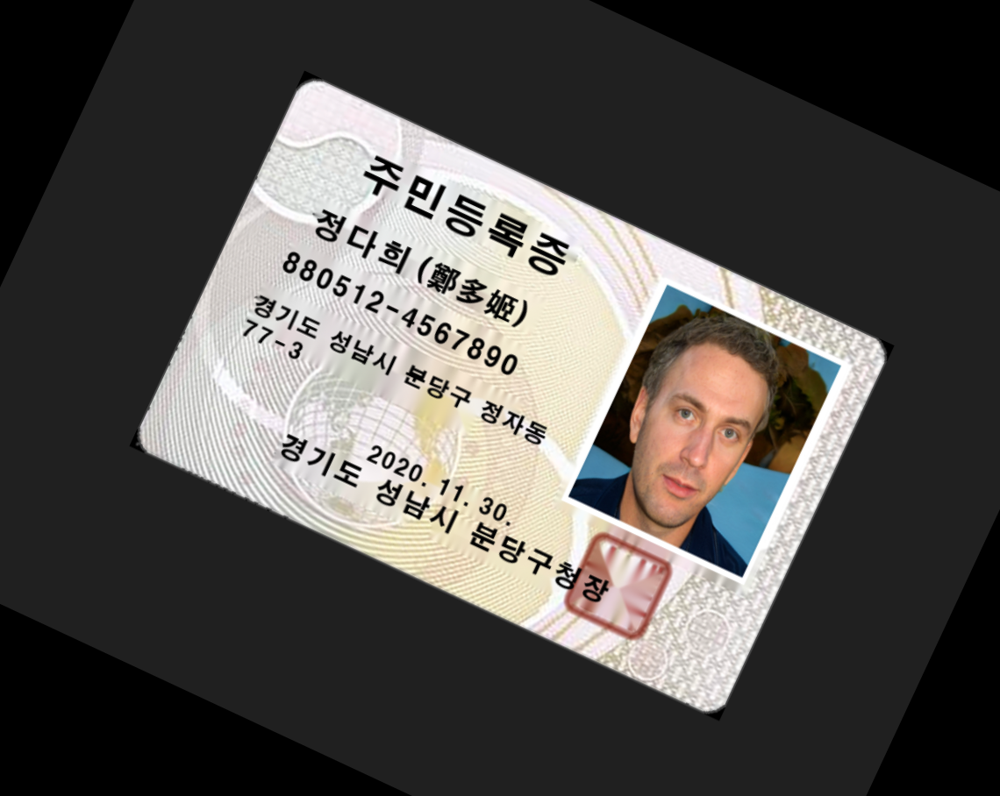

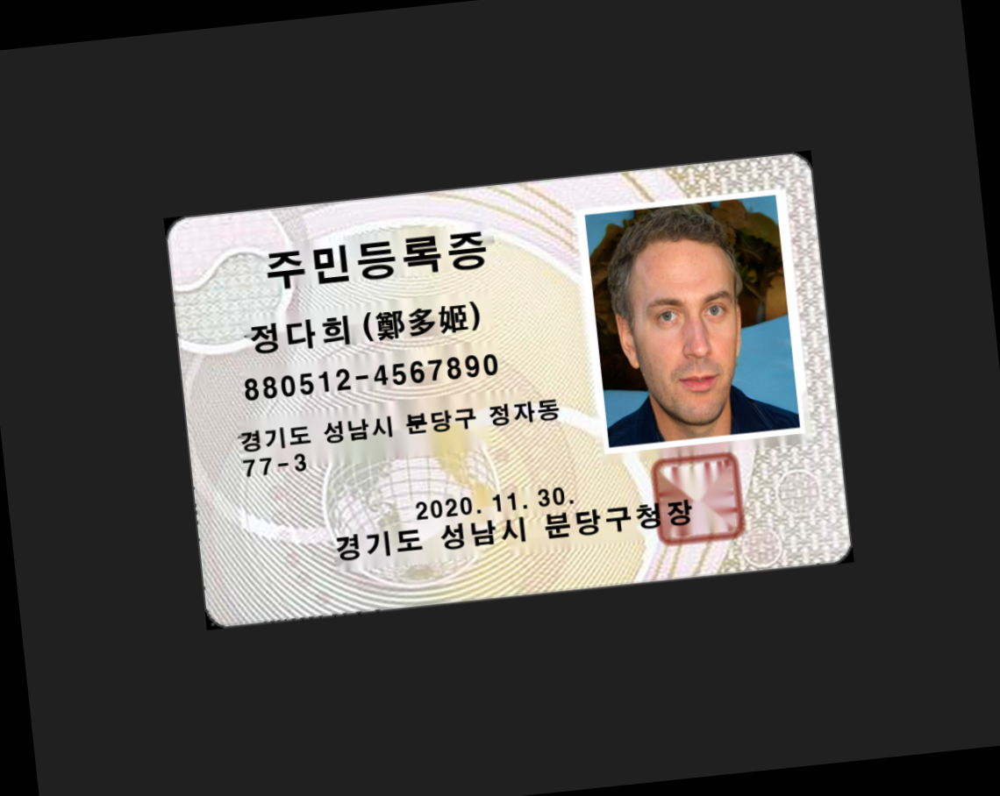

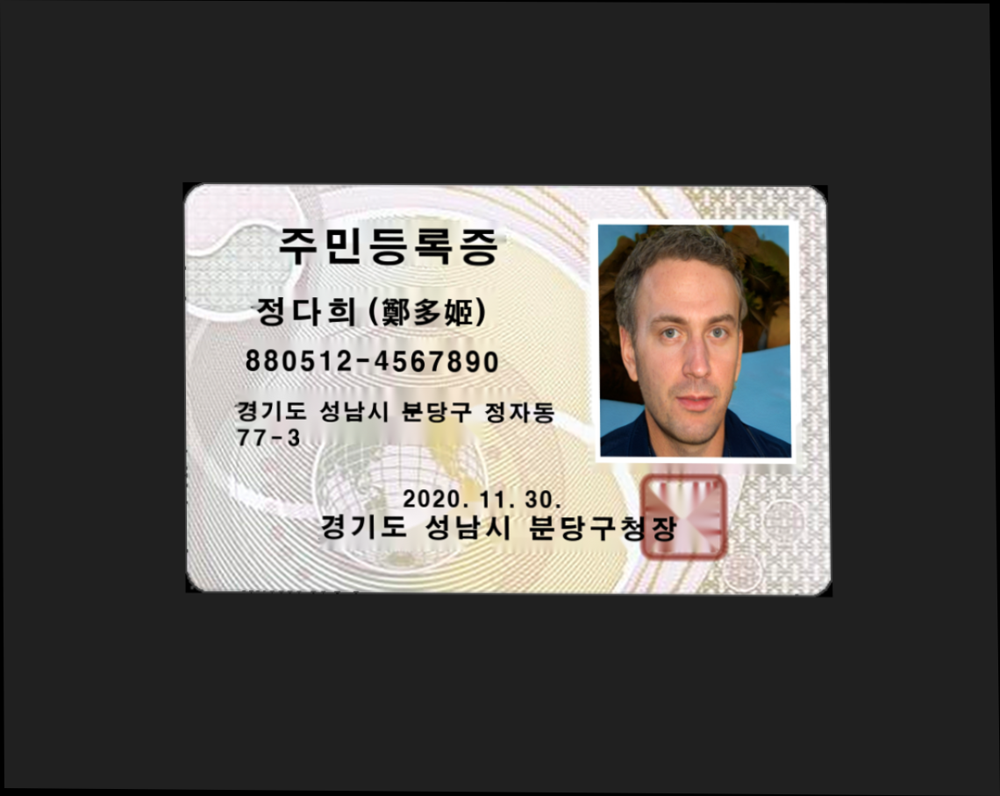

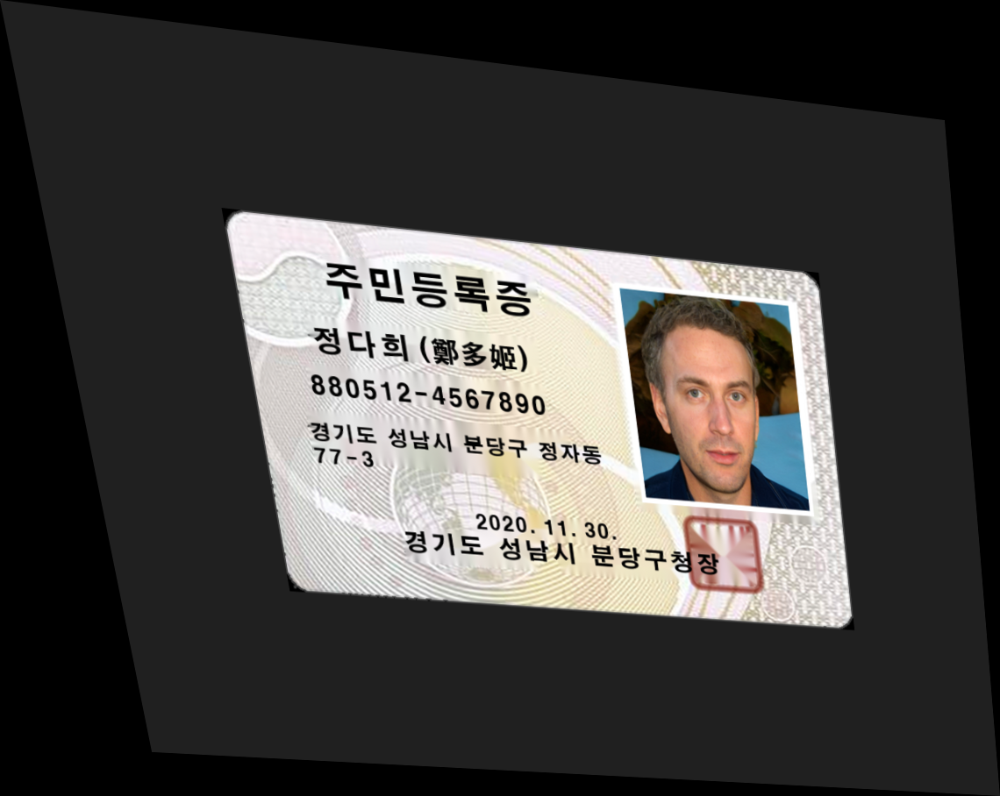

...

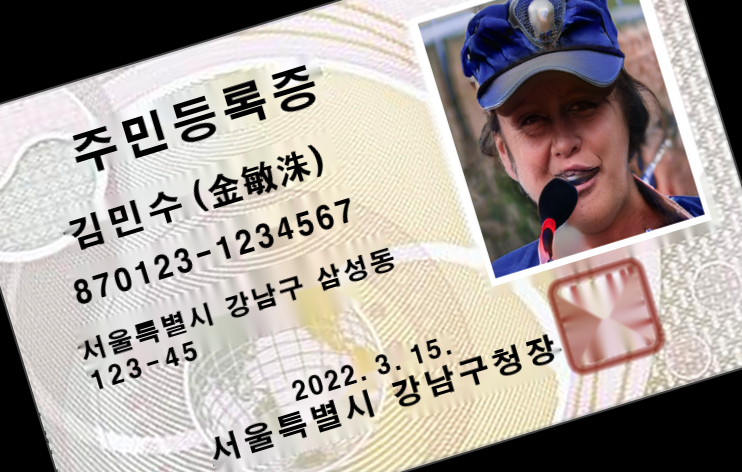

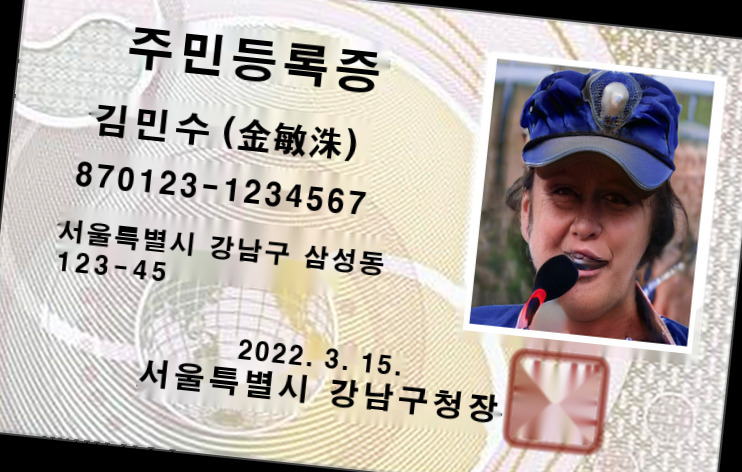

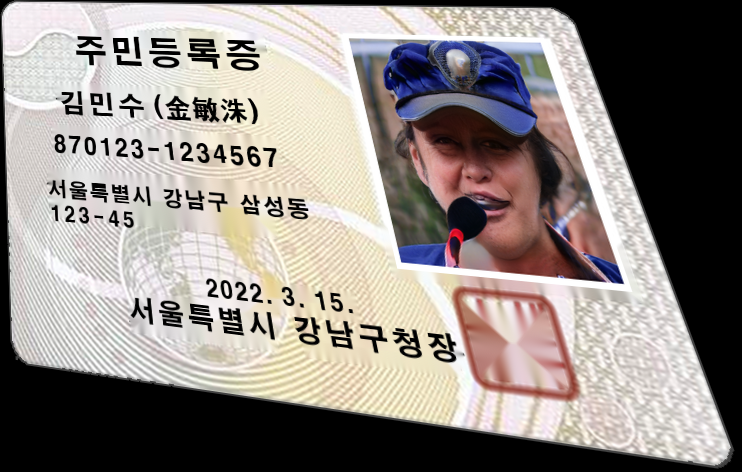

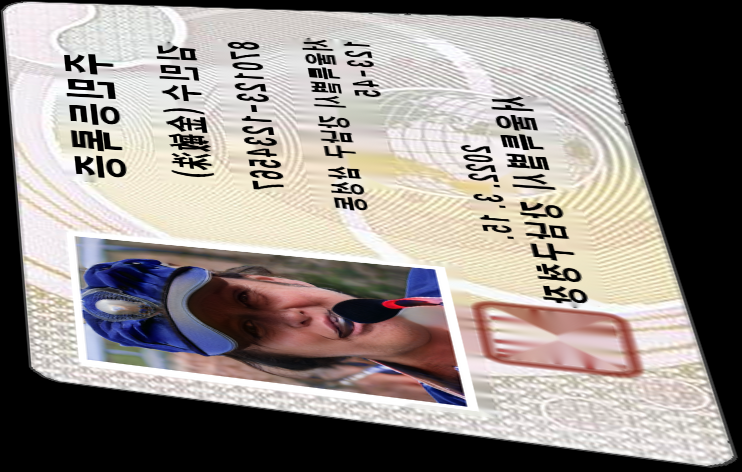

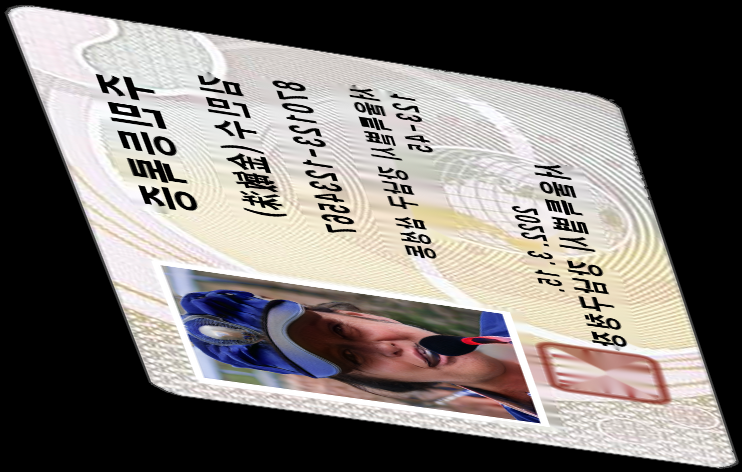

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
import random
from google.colab.patches import cv2_imshow


# 이미지가 저장된 폴더 경로
folder_path = '/content/images'  # 이미지 폴더 경로를 여기에 넣으세요

# 폴더 내 모든 파일에 대해 작업 수행
for filename in os.listdir(folder_path):
    if filename.endswith('.png') or filename.endswith('.jpg') or filename.endswith('.jpeg'):  # 이미지 파일 필터링
        image_path = os.path.join(folder_path, filename)
        image = cv2.imread(image_path)

        # 회전 적용
        angles = get_random_numbers(3, -40, 40)
        for angle in angles:
            rotated_image = rotate_image(image, angle)
            cv2_imshow(rotated_image)

        # 투시 변환 적용
        perspectives = generate_random_pairs(3)
        for perspective in perspectives:
            perspective_image = perspective_transform(image, perspective[0], perspective[1])
            cv2_imshow(perspective_image)


### 2. 빛의 밝기

In [ ]:
import random

def randomList(count):
    list = []
    for i in range(count):
        list.append((random.uniform(0.5, 1.5)))
    return list

In [ ]:
# 밝기 조절 함수
def adjust_brightness(image, brightness_factor):
    # 이미지의 타입을 float으로 변경
    image_float = image.astype(np.float32)
    # 밝기 조절
    image_bright = image_float * brightness_factor
    # 0~255 범위로 클리핑
    image_bright = np.clip(image_bright, 0, 255)
    # 다시 uint8 타입으로 변환
    return image_bright.astype(np.uint8)


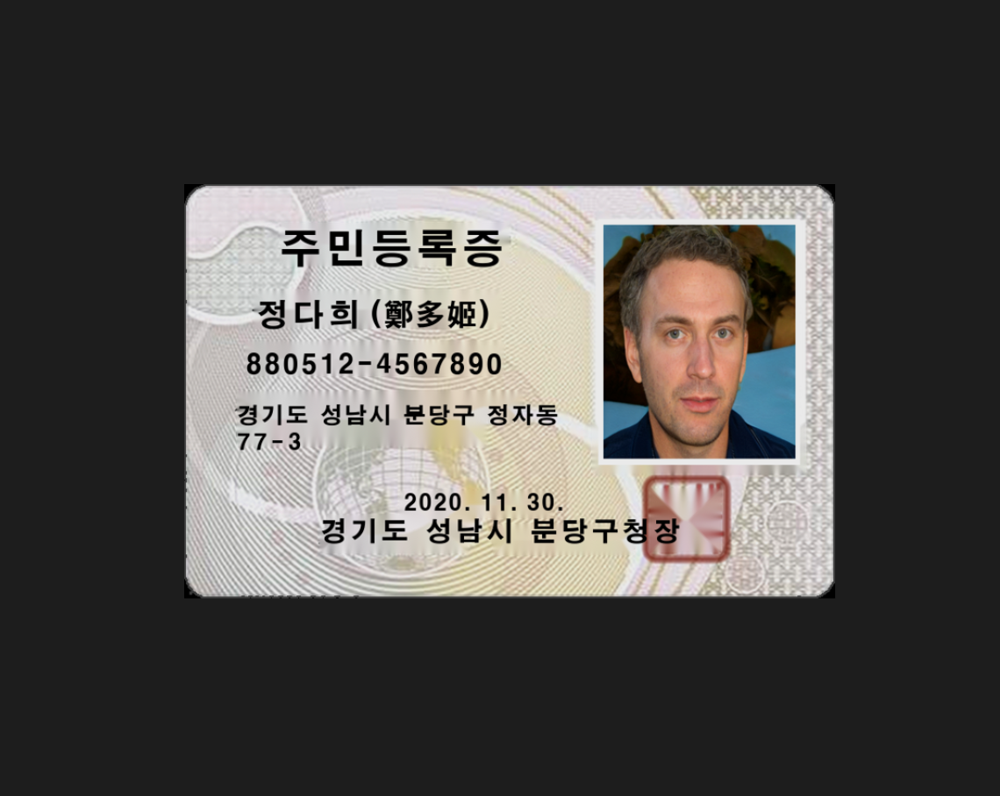

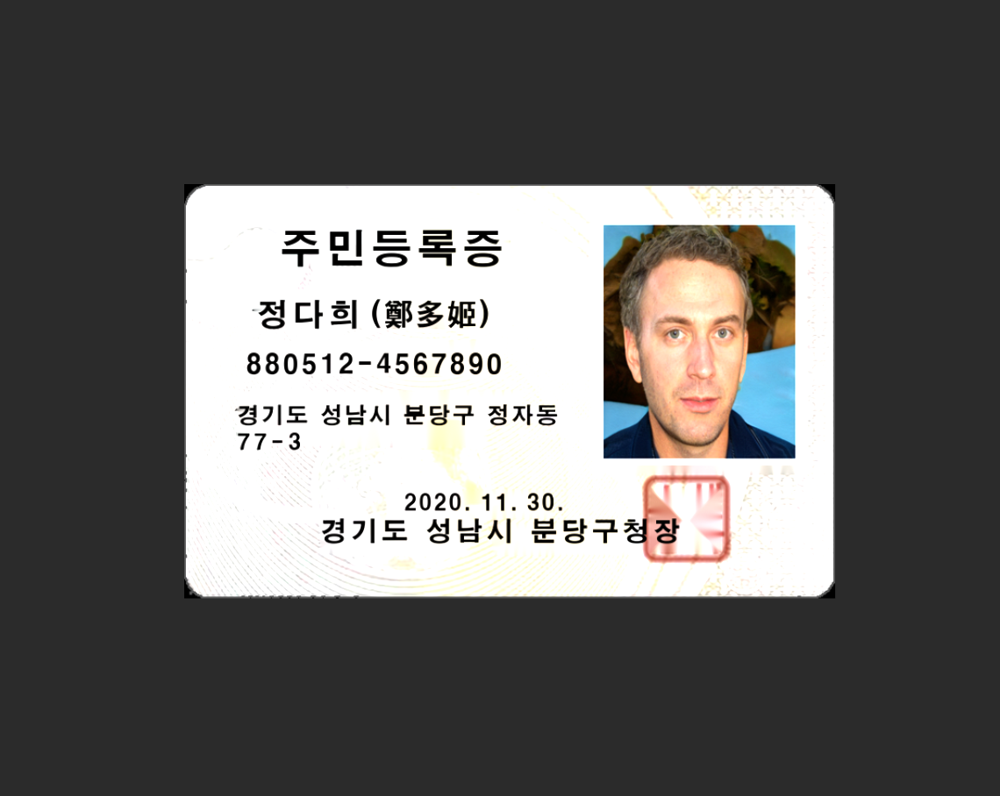

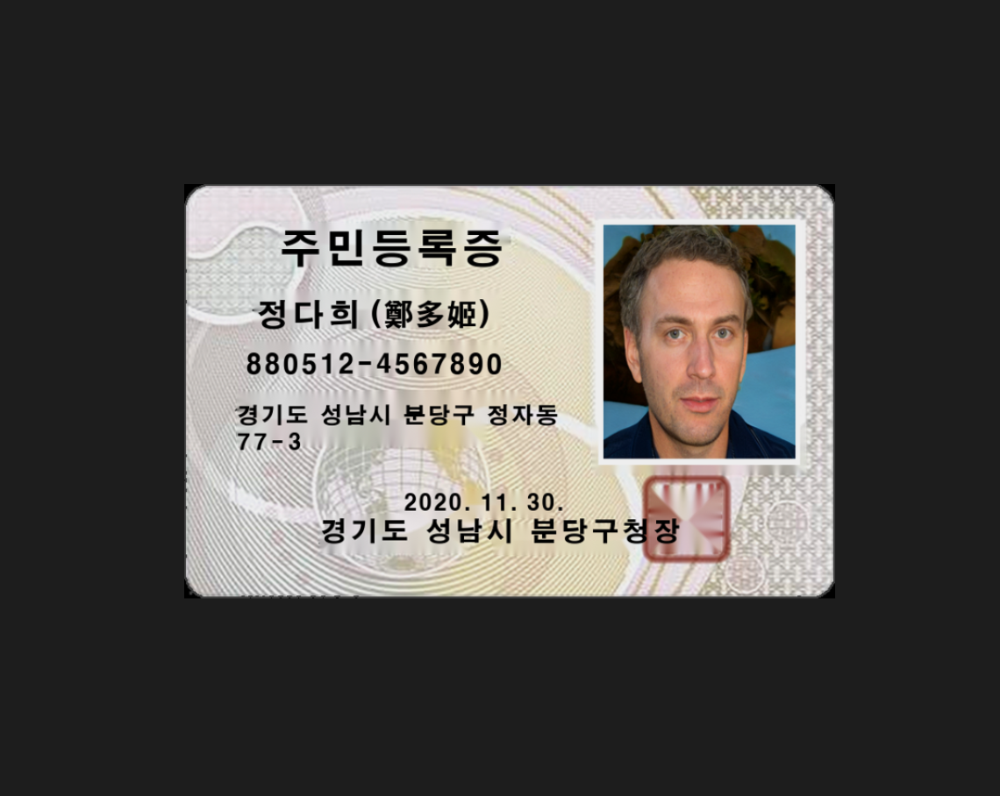

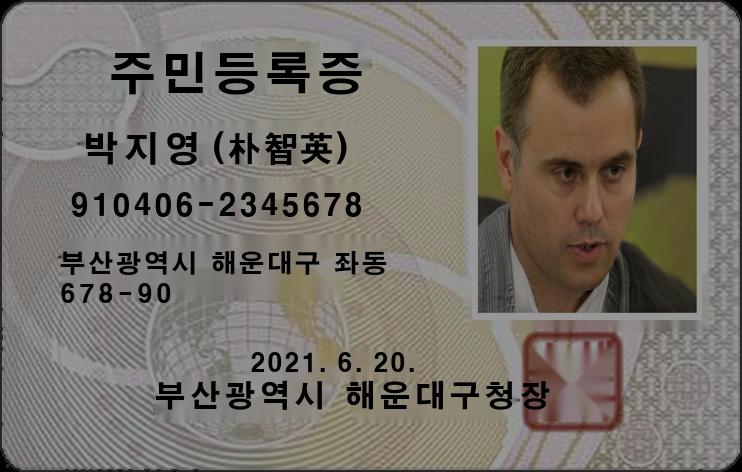

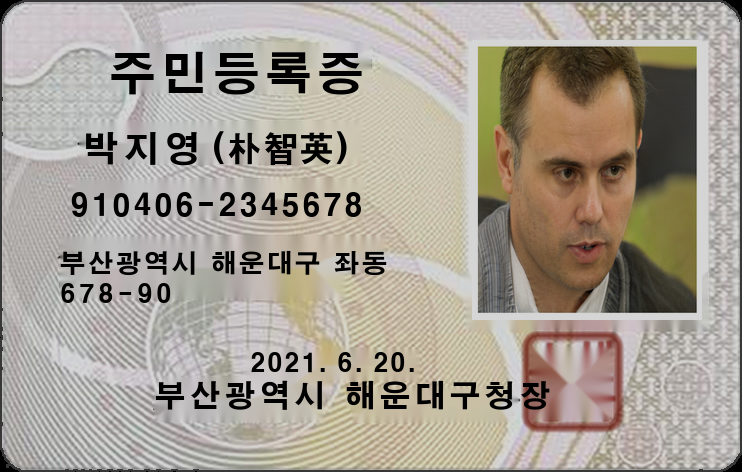

...

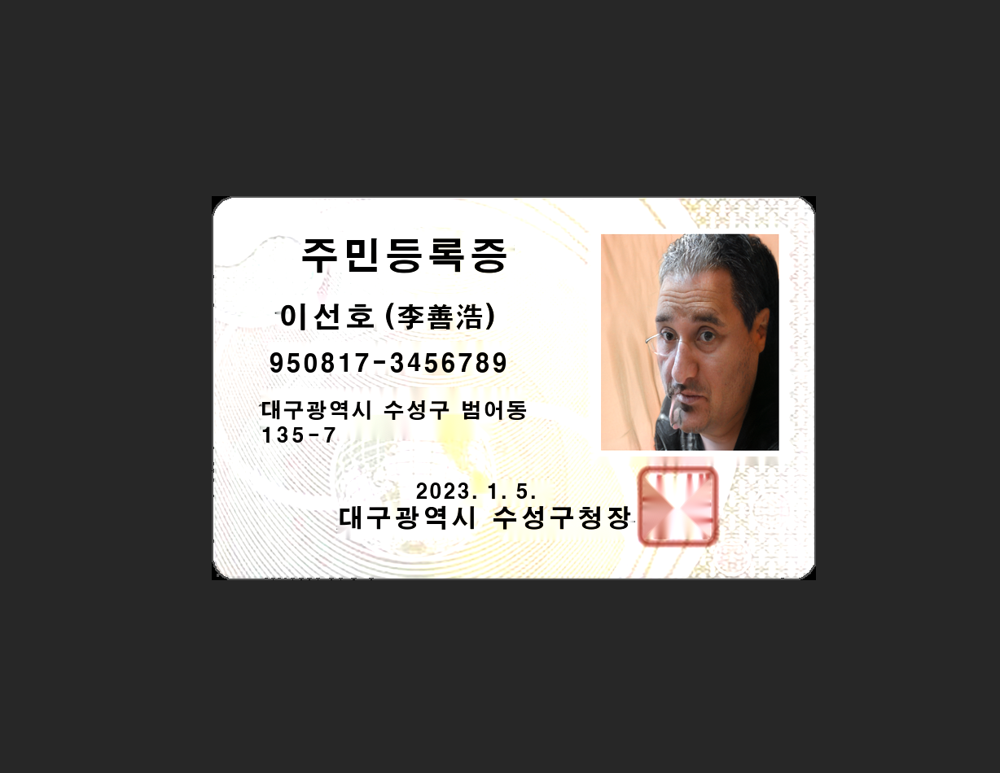

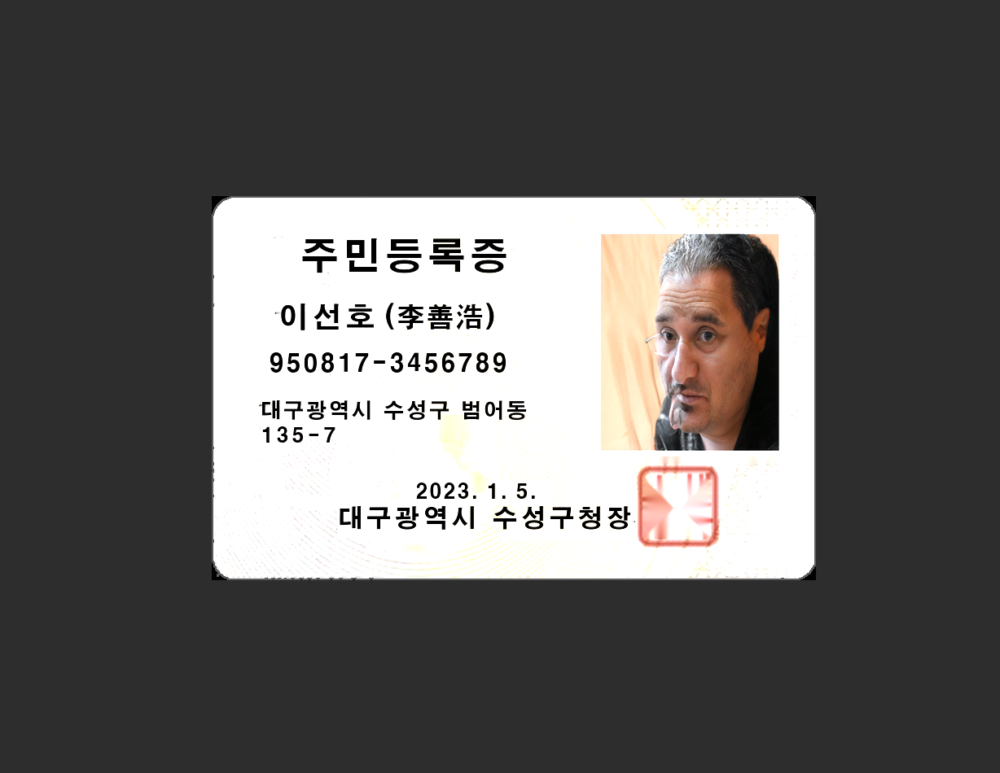

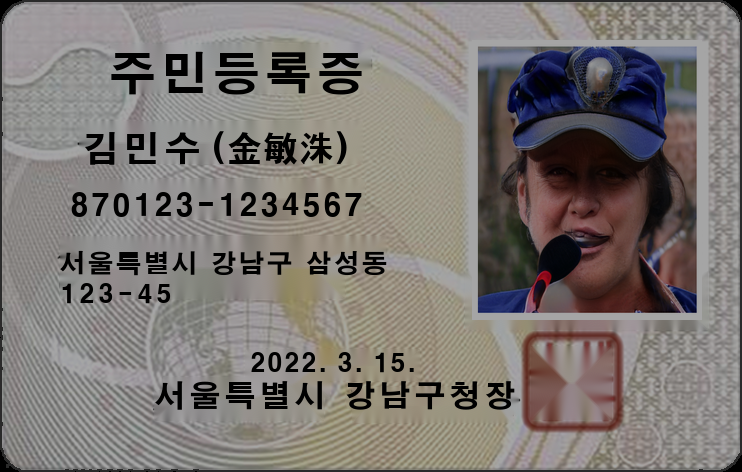

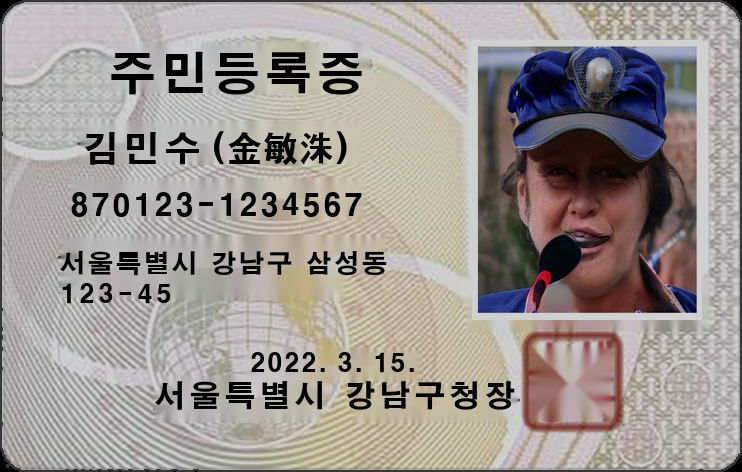

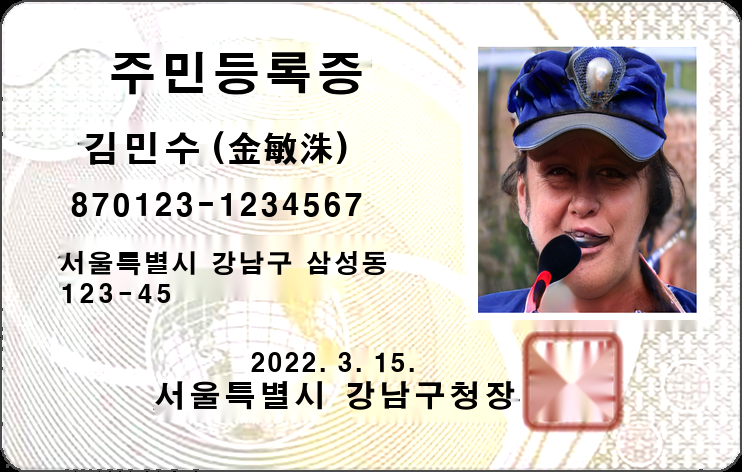

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# 이미지가 저장된 폴더 경로
folder_path = '/content/images'  # 이미지 폴더 경로를 여기에 넣으세요

# 폴더 내 모든 파일에 대해 작업 수행
for filename in os.listdir(folder_path):
    if filename.endswith('.png') or filename.endswith('.jpg') or filename.endswith('.jpeg'):  # 이미지 파일 필터링
        image_path = os.path.join(folder_path, filename)
        image = cv2.imread(image_path)

    # 다양한 밝기로 변형된 이미지 생성
    brightness_factors = randomList(3) # 밝기 계수 리스트

# 밝기 변형된 이미지들을 저장하고 출력
    for i, factor in enumerate(brightness_factors):
      bright_image = adjust_brightness(image, factor)
      cv2_imshow(bright_image)



### 3. 해상도와 화질 조정

In [ ]:
def adjust_resolution(image, scale_percent):
    width = int(image.shape[1] * scale_percent / 100)
    height = int(image.shape[0] * scale_percent / 100)
    dim = (width, height)
    resized_image = cv2.resize(image, dim, interpolation=cv2.INTER_AREA)
    # 원래 크기로 다시 리사이즈
    original_size_image = cv2.resize(resized_image, (image.shape[1], image.shape[0]), interpolation=cv2.INTER_NEAREST)
    return original_size_image

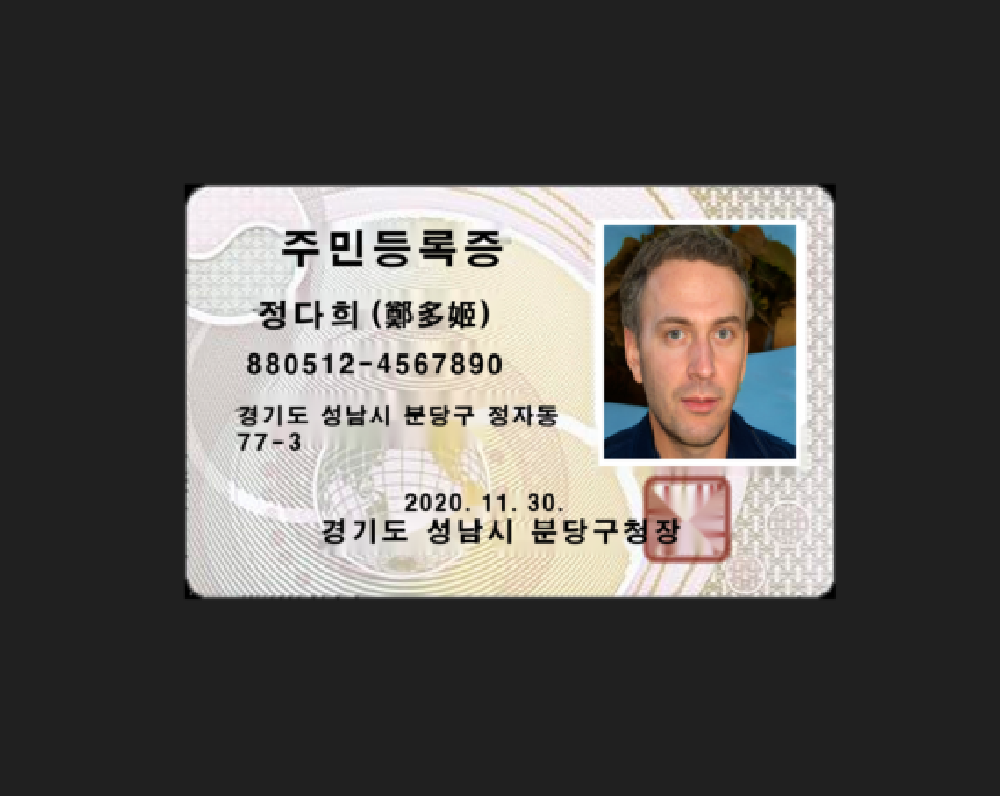

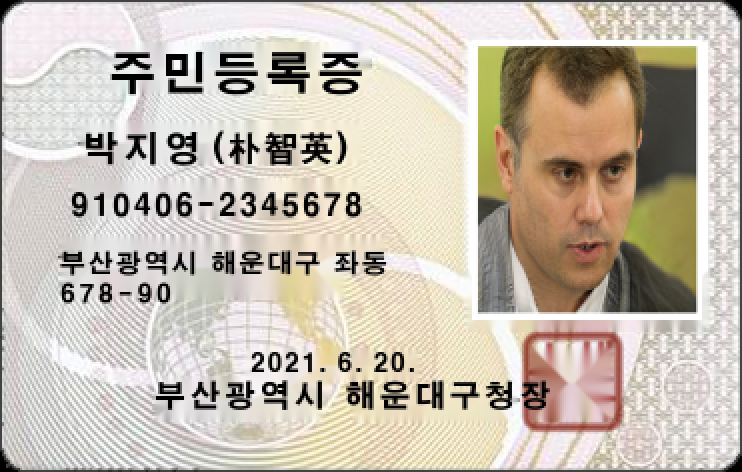

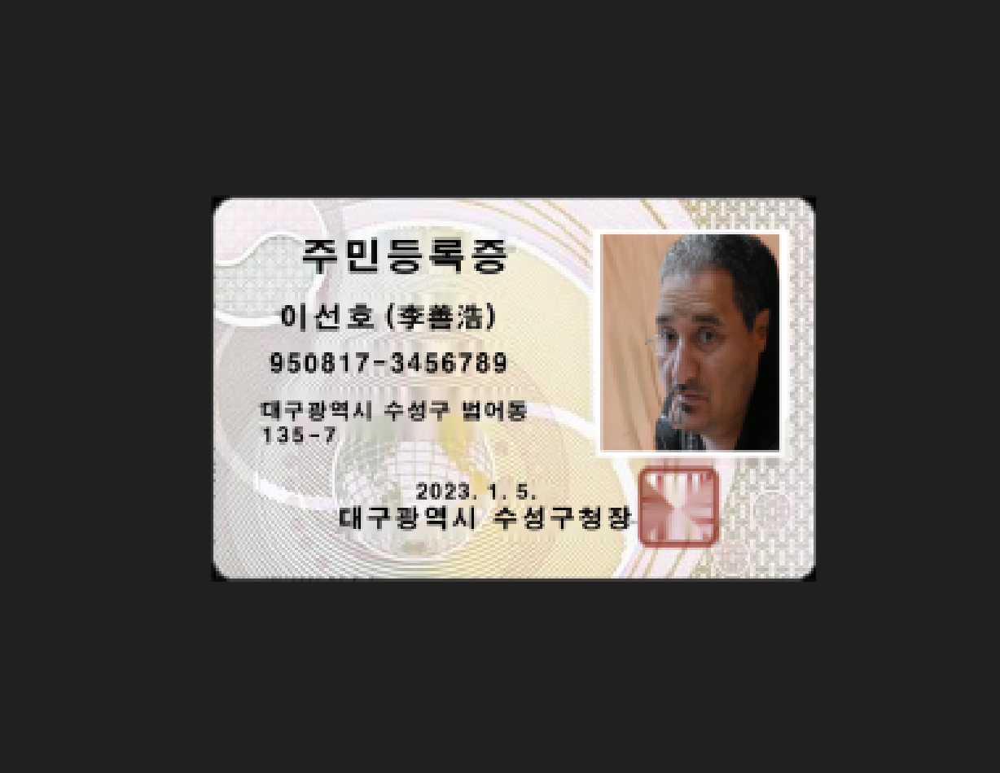

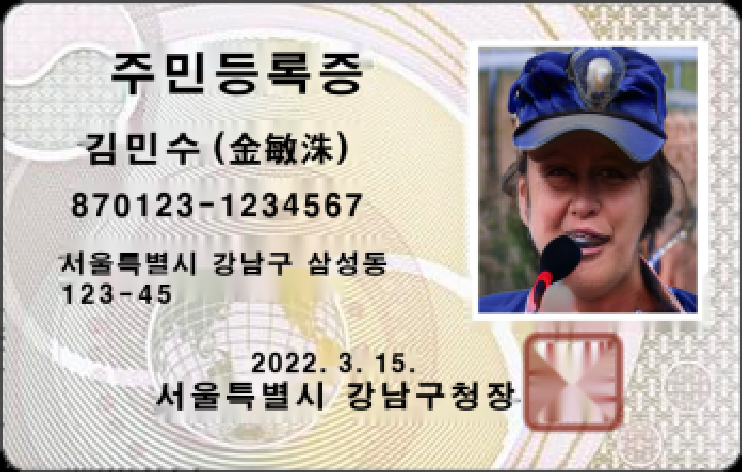

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import random
import os

#이미지가 저장된 폴더 경로
folder_path = '/content/images'  # 이미지 폴더 경로를 여기에 넣으세요

# 폴더 내 모든 파일에 대해 작업 수행
for filename in os.listdir(folder_path):
    if filename.endswith('.png') or filename.endswith('.jpg') or filename.endswith('.jpeg'):  # 이미지 파일 필터링
        image_path = os.path.join(folder_path, filename)
        image = cv2.imread(image_path)

  # 예제 사용
        low_res_image = adjust_resolution(image, random.randint(25,50))  # 해상도 30%로 축소 후 원래 크기로 리사이즈
        cv2_imshow(low_res_image)



### 5. 부분적으로 가려진 신분증

In [ ]:
import cv2
def occlude_image(image, x_start, y_start, width, height):
    occluded_image = image.copy()
    cv2.rectangle(occluded_image, (x_start, y_start), (x_start + width, y_start + height), (0, 0, 0), -1)
    return occluded_image

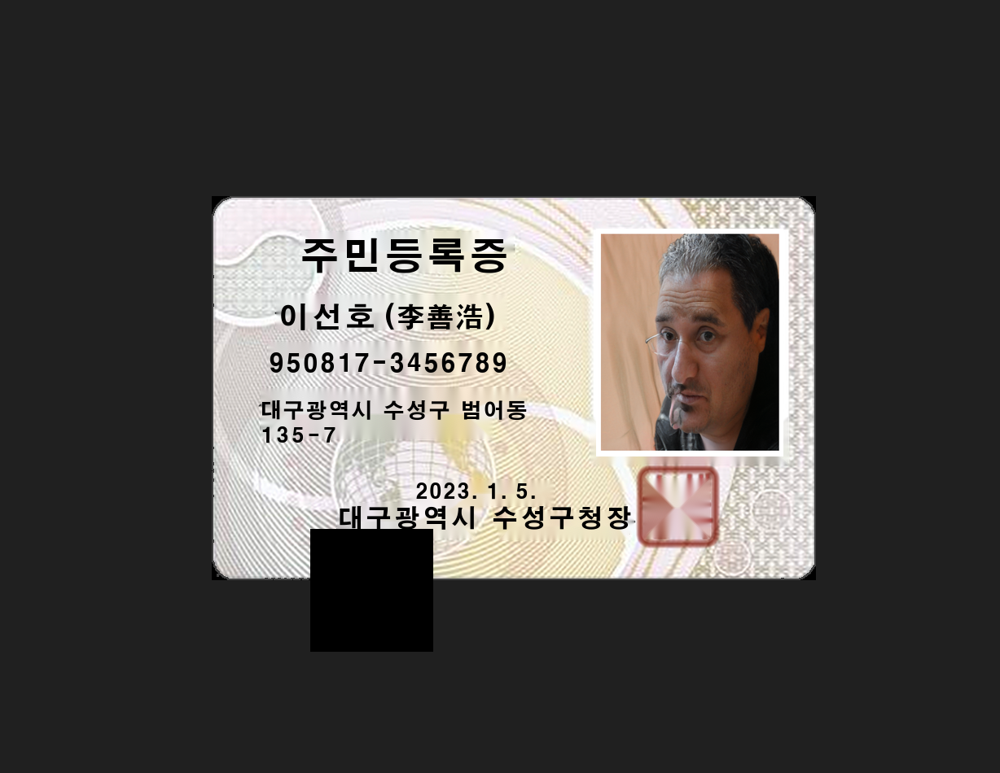

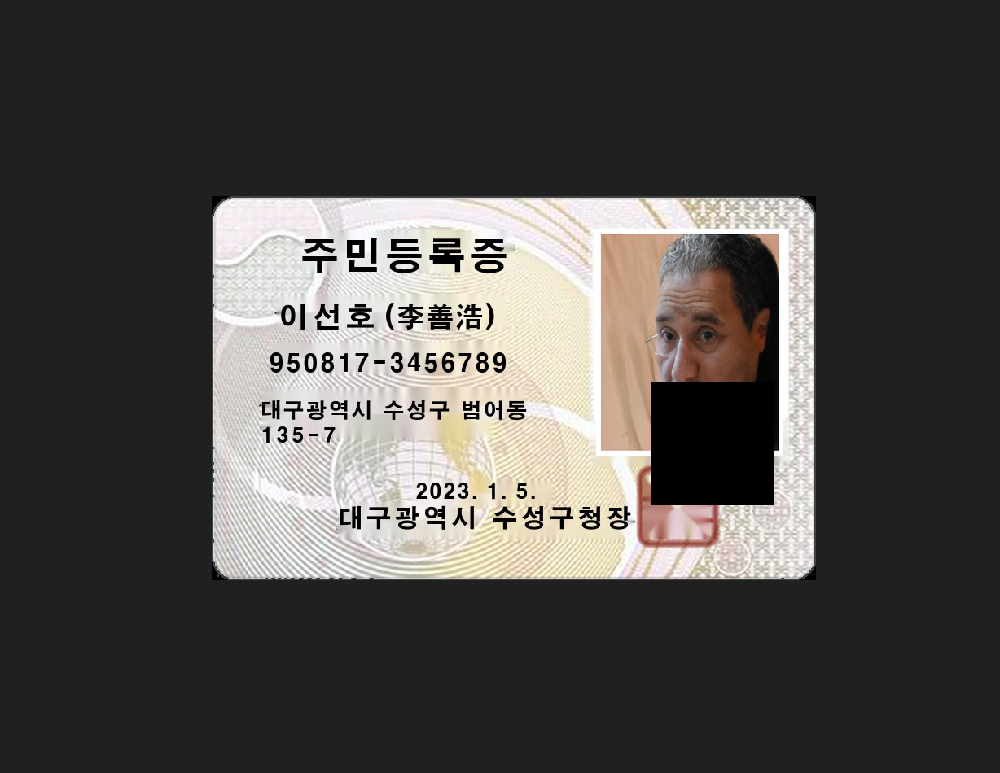

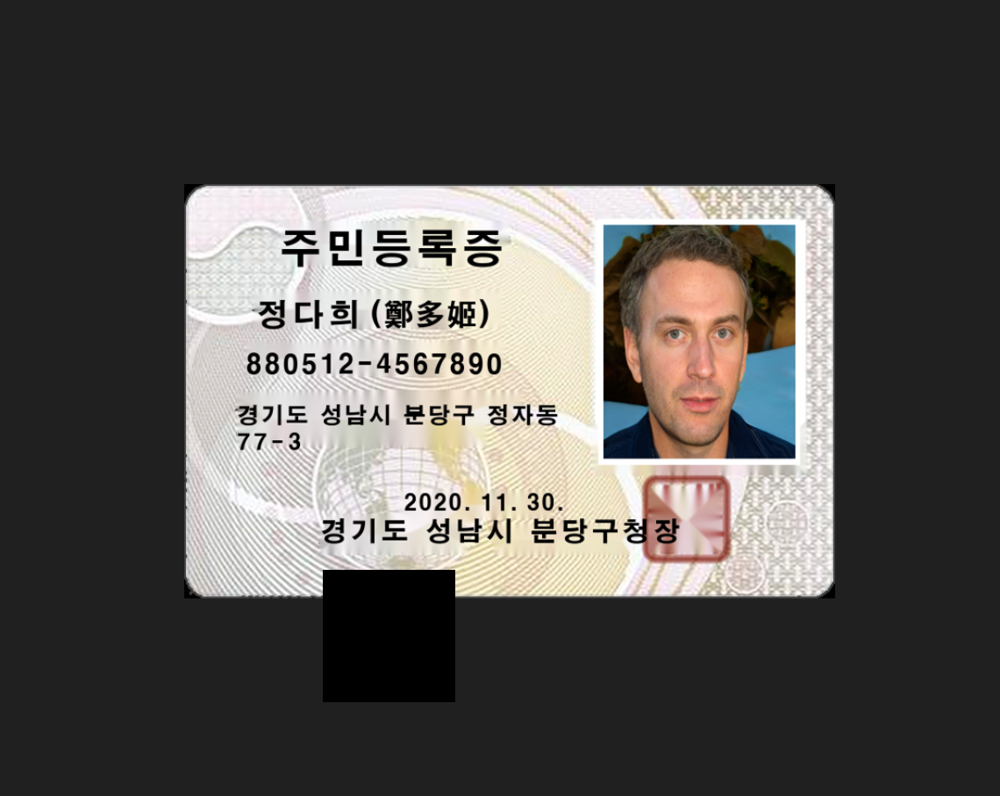

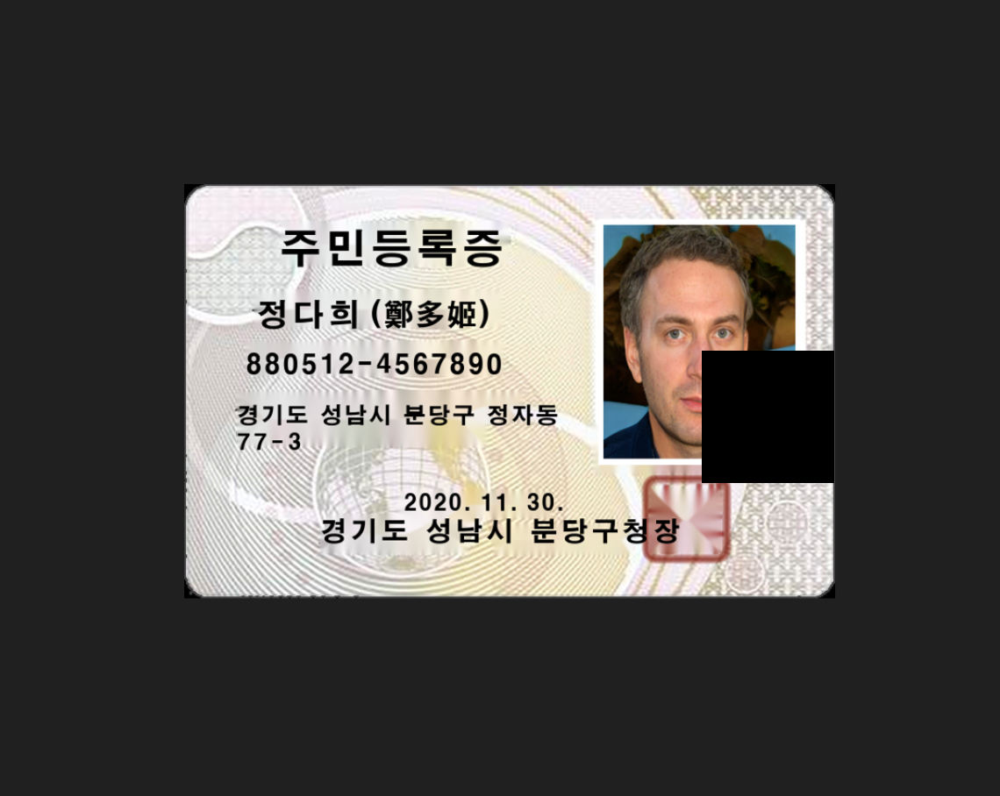

In [ ]:
#이미지가 저장된 폴더 경로
folder_path = '/content/data'  # 이미지 폴더 경로를 여기에 넣으세요

# 폴더 내 모든 파일에 대해 작업 수행
for i in range(2):
  image_path='/content/data/idcard_far{0}.png'.format(i+1)
  image = cv2.imread(image_path)

  occluded_image1 = occlude_image(image,random.randint(250,400),650, 150, 150)  # 특정 영역을 검은색으로 가림
  occluded_image2 = occlude_image(image, 800, random.randint(200,500), 150, 150)
  cv2_imshow(occluded_image1)
  cv2_imshow(occluded_image2)

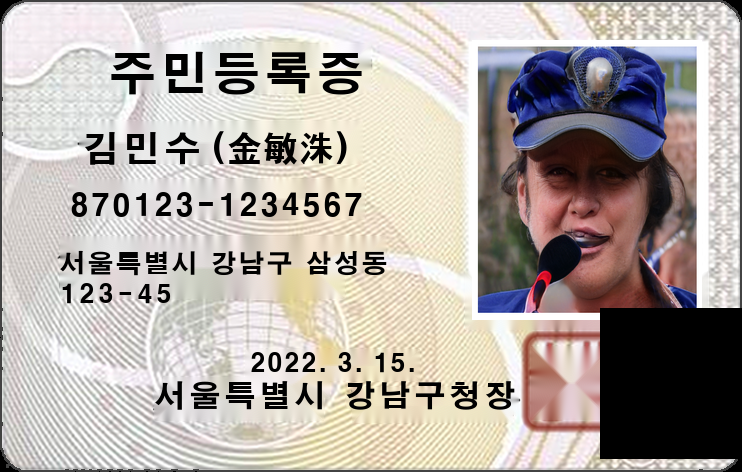

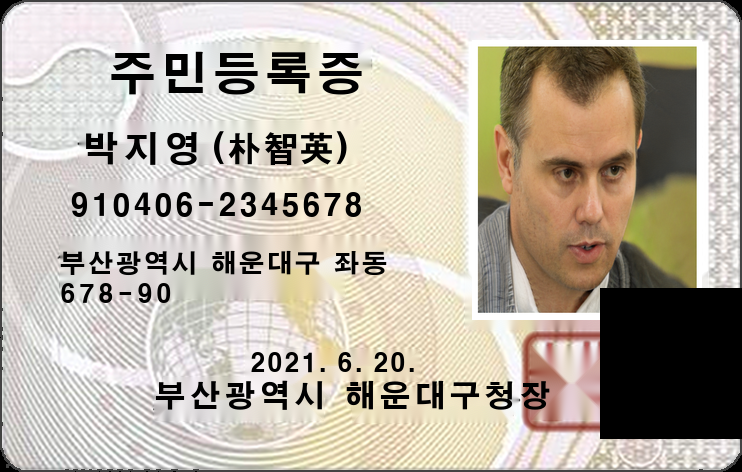

In [ ]:
#이미지가 저장된 폴더 경로
folder_path = '/content/data'  # 이미지 폴더 경로를 여기에 넣으세요

# 폴더 내 모든 파일에 대해 작업 수행
for i in range(2):
  image_path='/content/data/idcard_near{0}.png'.format(i+1)
  image = cv2.imread(image_path)

  occluded_image1 = occlude_image(image,600,random.randint(50,400), 150, 150)  # 특정 영역을 검은색으로 가림
  cv2_imshow(occluded_image1)

### 6. 손상된 신분증

In [ ]:
def damage_image(image, damage_type='noise', severity=5):
    damaged_image = image.copy()
    if damage_type == 'noise':
        noise = np.random.randint(0, 256, damaged_image.shape, dtype=np.uint8)
        damaged_image = cv2.addWeighted(damaged_image, 1 - severity / 10, noise, severity / 10, 0)
    elif damage_type == 'pixelation':
        height, width = damaged_image.shape[:2]
        temp = cv2.resize(damaged_image, (width // severity, height // severity), interpolation=cv2.INTER_NEAREST)
        damaged_image = cv2.resize(temp, (width, height), interpolation=cv2.INTER_NEAREST)
    return damaged_image


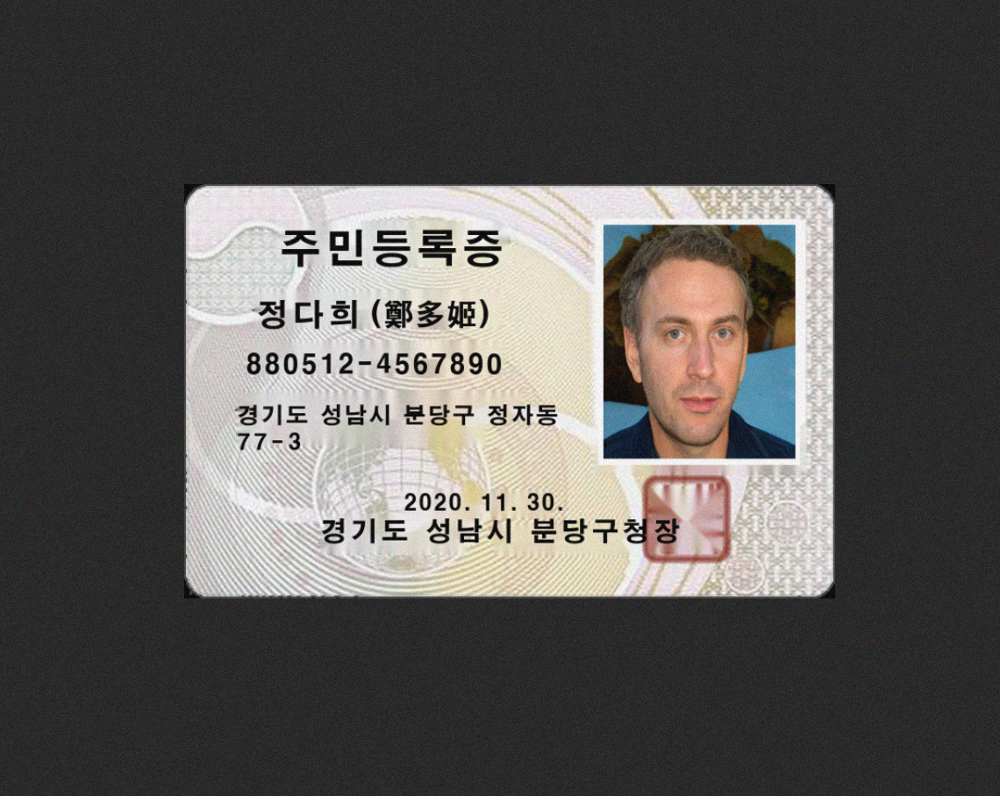

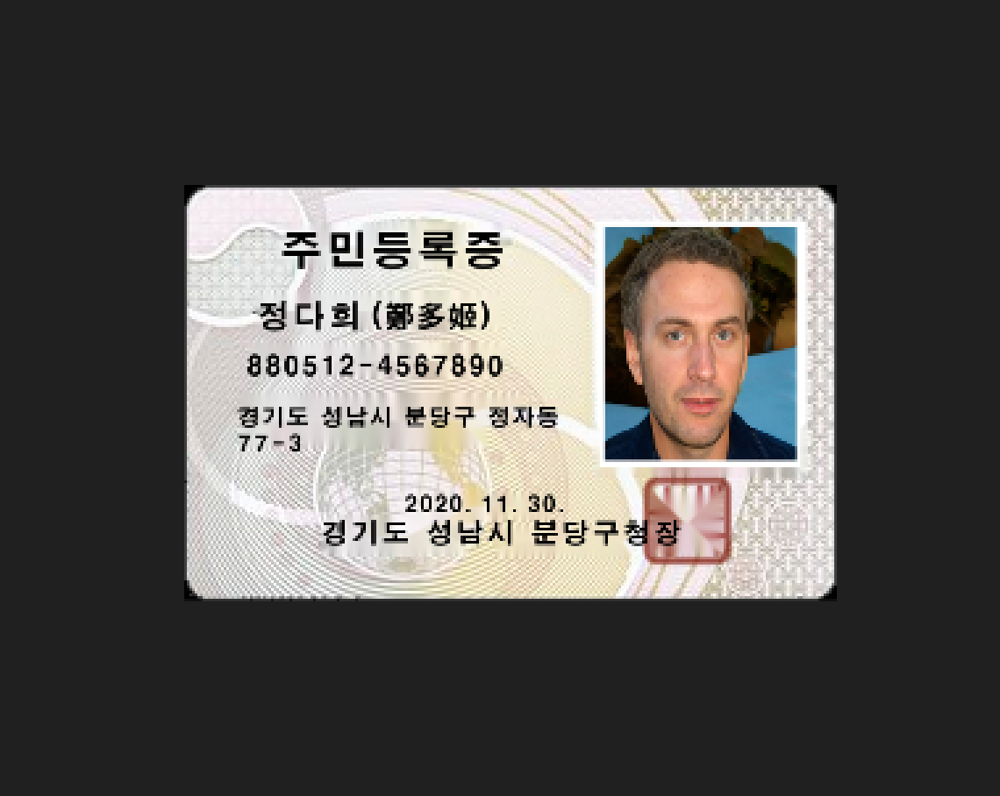

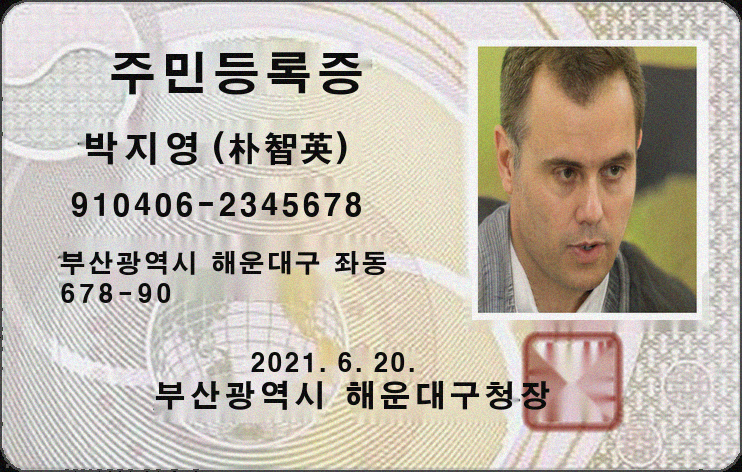

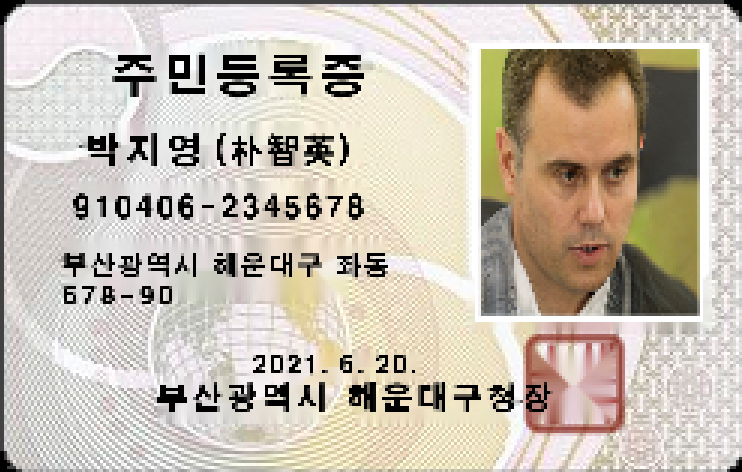

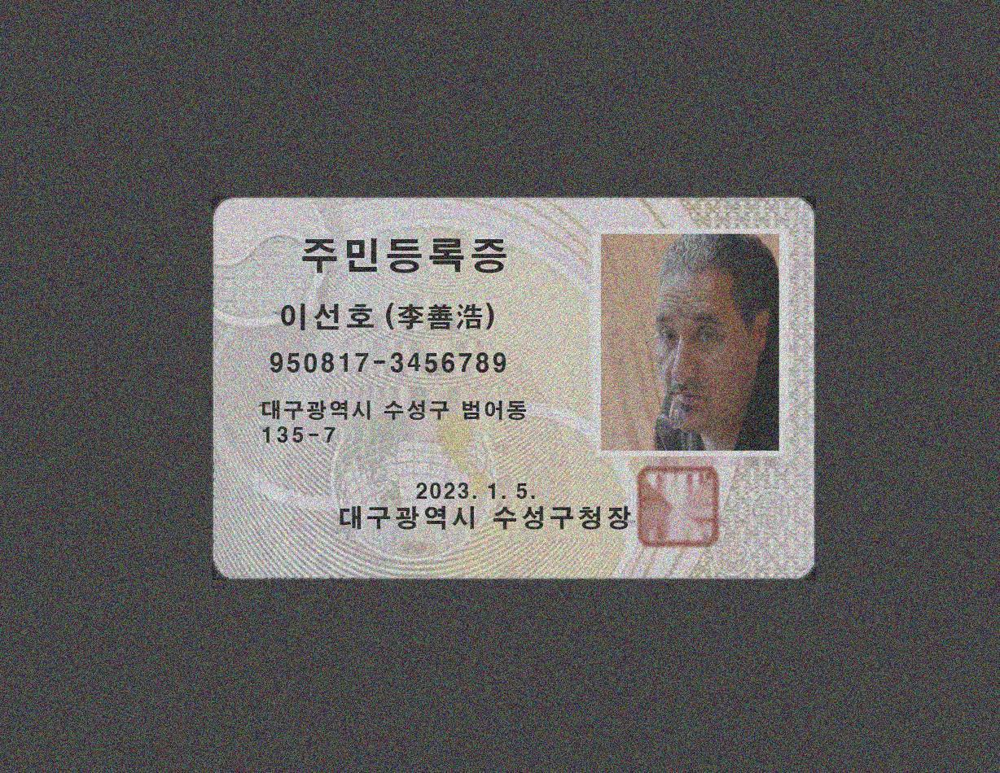

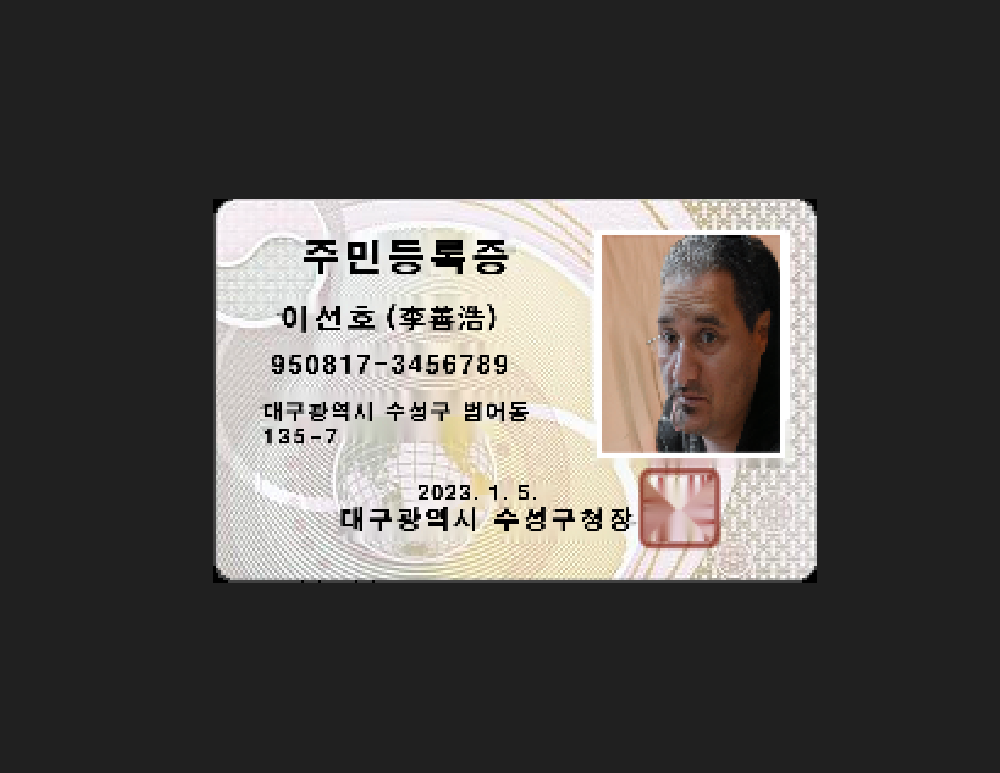

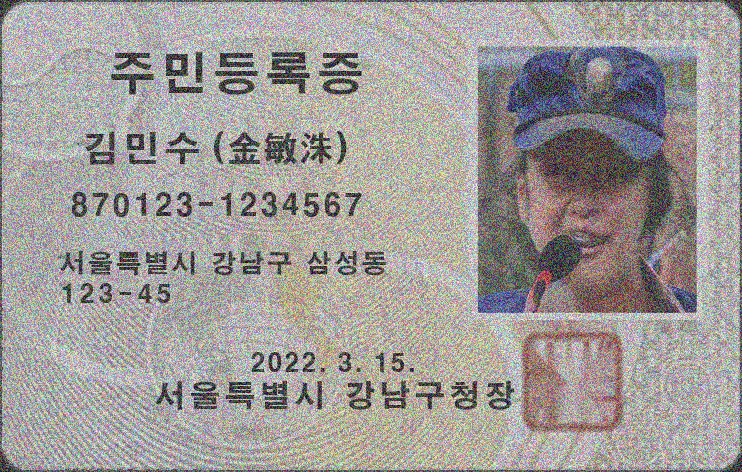

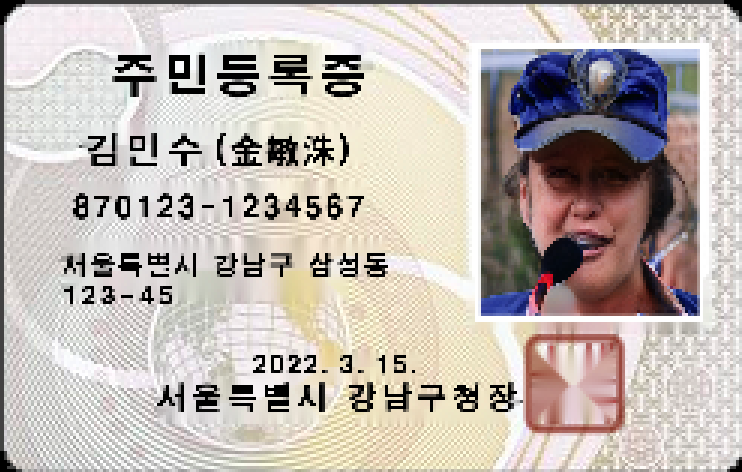

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import random
import os

#이미지가 저장된 폴더 경로
folder_path = '/content/data'  # 이미지 폴더 경로를 여기에 넣으세요

# 폴더 내 모든 파일에 대해 작업 수행
for filename in os.listdir(folder_path):
    if filename.endswith('.png') or filename.endswith('.jpg') or filename.endswith('.jpeg'):  # 이미지 파일 필터링
        image_path = os.path.join(folder_path, filename)
        image = cv2.imread(image_path)
        noisy_image = damage_image(image, 'noise', severity=random.randint(1, 6))  # 노이즈 추가
        pixelated_image = damage_image(image, 'pixelation', severity=random.randint(1,3))  # 화소 손상
        cv2_imshow(noisy_image)
        cv2_imshow(pixelated_image)